## 회고

#### Point 1) Custom Loss Function 만들기
- 이번 프로젝트에서 제일 끝 head의 output은 (batch_size, 224, 224, 1)의 이미지를 반환하는 것으로 모델을 짰다.(도로 or 배경만 판단하면 되는 거라서... 마지막에도 `sigmoid`이용)
- 그런데 저렇게 채널 차원이 1이면 `model.fit()`에서 loss_function에 들어갈 때 알아서 차원을 줄여주는 것 같다.
- 위와 같은 경우 loss_function에 들어가는 y_pred(모델의 output) shape은 아래와 같이 나온다.
  - `y_pred.shape : (None, 224, 224)` (원래 같으면 (None, 224, 224, 1)이어야 하는 것 같은데...)
- 그러나 모델의 output을 (batch_size, 224, 224, 2) 같이 multiple한 classification 문제로 만들어버리면 마지막 차원을 줄이지 않는 것 같다.
- 아래는 위와 같은 경우 loss_function에 들어가는 y_pred의 shape이다.
  - `y_pred.shape : (None, 224, 224, 2)`
- 그런데 참고로 가장 위의 경우와 같이 `num_classes=1`로 형성해도 실제 `model(input)`을 한 output을 뽑아내서 shape을 확인해보면 **(batch_size, 224, 224, 1)**로 나온다. 뭔가 신기하다...

#### Point 2) tensorflow에 맞는 자료형 및 함수 쓰기
- loss_function 안에서 `y_true.shape`으로 하니 `(None, None, None)`이 나와서 오류가 뜬다.
- `tf.shape(y_true)`를 써야 한다.

#### Point 3) multiple outputs에 대한 multiple losses 구하는 법 만들기
- UNet++의 경우 Deep Supervision을 하는 형태로 하면 총 4개의 output이 나오고 이들 각각의 로스에 대한 weighted sum을 하는 형식이다.
- 그런데 맨 처음에 이 4개의 output에 대한 loss 구하는 법을 잘 몰라 헤맸다.
- 맨 처음 시도한 건 `loss_function`에서 for loop을 통해 output 하나마다 loss 계산을 하는 식으로 생각했는데(`(output_num, batch_size, H, W, C)`의 shape을 갖는다고 생각했다), 구현해보니 그렇게 하면 계속 오류가 났다.
- 결과적으로 loss는 output 1개마다 되게끔 keras에서 구현이 되어 있는 것 같고, multiple output의 경우 딕셔너리 형태로 그에 해당하는 loss_function을 매칭해주면 되는 것이었다.

#### Point 4) UNet++ 공식 코드로 구현한 모델의 loss 값이 `nan` 값이 나왔을 때
- UNet++ 공식 코드로 구현한 모델의 loss 값이 `nan`이 나왔다.(내가 구현한 맨 처음 loss_function을 썼을 때. 그리고 다른 모델들은 그래도 다른 숫자가 나오긴 했다.)
- 같은 데이터셋과 같은 loss_function을 이용했는데도 그렇게 나오길래 모델 쪽에 문제가 있지 않을까 싶었다.
- 사실 얼핏 봤을 때는 전혀 아무런 문제가 없었는데, 모델 함수 중 18번행에 `global bn_axis`라고 해놓은 부분이 있었다.
- 그런데 그 부분 때문에 모델이 계속 `nan`값의 loss 및 output을 내보내고 있었다.
- 왜일까...? 추측하기로는 함수 안에 있는 변수명이 global scope로 바뀌면서 tensorflow graph를 만드는 데 이상하게 작동한 게 아닌가 싶다...
- 여튼 해결 방법은 `global bn_axis`부분을 삭제했다.
  - _**그러나 그 후에도 몇 번 실험해봤을 때 `nan`으로 나왔다 안 나왔다해서 결국엔 loss_function에 따라 그 값이 `nan`으로 나오게 되는 것 같아서 중간부터 `binary_crossentropy`로 loss_function을 바꿨다.**_

## 프로젝트 : 개선된 U-Net 모델 만들기

#### 배경
- U-Net 모델을 구현해봤다.
- Segmentation task에 필요한 개념들을 이해했다.
- U-Net++ 논문을 읽고 개선된 U-Net 모델을 만들어서 기존 버전과 정성, 정량적 비교를 해보자.

### 1) 라이브버리 버전 확인
---

In [1]:
import tensorflow as tf
import numpy as np
import PIL
import skimage
import albumentations as A
import os
import math
import cv2
from glob import glob
import matplotlib.pyplot as plt
import skimage.io

print(tf.__version__)
print(np.__version__)
print(PIL.__version__)
print(skimage.__version__)
print(A.__version__)

2.8.0
1.21.5
7.1.2
0.18.3
0.1.12


### 2) 데이터셋 준비

In [2]:
from google.colab import drive
drive.mount('/content/drive')

Mounted at /content/drive


In [3]:
# cd /content/drive/My Drive/Aiffel/GD_10

In [4]:
# !wget https://www.dropbox.com/s/thhq5312hdwo494/KITTI.zip

In [5]:
# !unzip KITTI.zip

In [6]:
training_path = '/content/drive/My Drive/Aiffel/GD_10/training'
testing_path = '/content/drive/My Drive/Aiffel/GD_10/testing'
model_path = training_path + '/seg_model_unet.h5'

### 3) 데이터 파이프라인 형성
---
- `albumentations`을 통해 data augmentation이 적용된 파이프라인을 만든다.

In [7]:
# albumentations 설치 여부 확인
!pip list | grep albumentations

albumentations                0.1.12


In [8]:
# data augmentation 함수
# train set이 아닌 경우에는 resize만 적용한다.
def augmentation_tool(is_train=True):
    if is_train:
        tool = A.Compose([A.HorizontalFlip(p=0.5),
                   A.RandomSizedCrop(min_max_height=(300, 370),
                                     w2h_ratio=370/1242,
                                     height=224,
                                     width=224,
                                     p=0.5),
                   A.Resize(width=224, height=224)])
        return tool
    else:
        tool = A.Compose([A.Resize(width=224, height=224)])
        return tool

In [9]:
# 적용한 거 예시 확인
augmenter_train = augmentation_tool(is_train=True)
augmenter_test = augmentation_tool(is_train=False)
images = glob(os.path.join(training_path, "image_2", "*.png"))

In [10]:
print(f"images len : {len(images)}")
print(f"images[:3] : {images[:3]}")

images len : 200
images[:3] : ['/content/drive/My Drive/Aiffel/GD_10/training/image_2/000099_10.png', '/content/drive/My Drive/Aiffel/GD_10/training/image_2/000153_10.png', '/content/drive/My Drive/Aiffel/GD_10/training/image_2/000158_10.png']


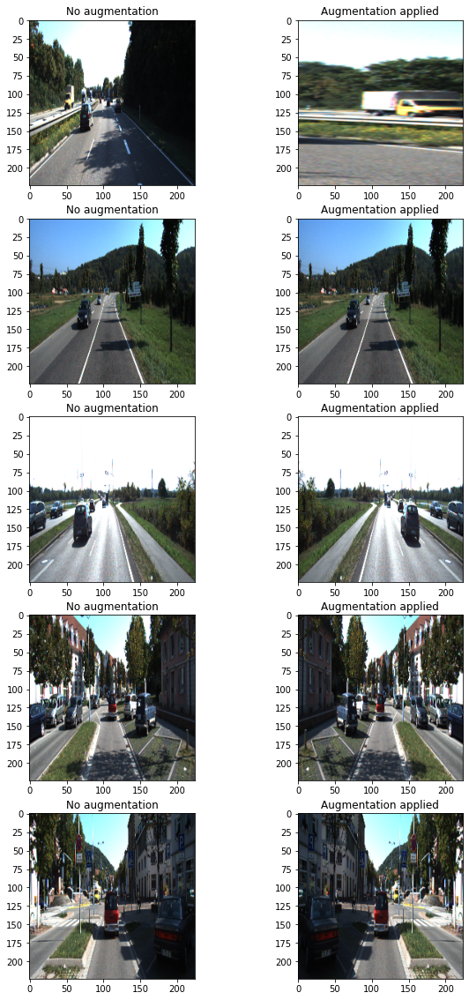

In [11]:
plt.figure(figsize=(10, 20))
for i in range(5):
    img = cv2.imread(images[i+10])
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    img_augmented = augmenter_train(image=img)
    img_resized = augmenter_test(image=img)
    plt.subplot(5, 2, 2*i+1)
    plt.imshow(img_resized['image'])
    plt.title('No augmentation')
    plt.subplot(5, 2, 2*i+2)
    plt.imshow(img_augmented['image'])
    plt.title("Augmentation applied")

plt.show()

> **note**:
> - `albumentations`을 통해 augment한 이미지는 `dict`형태로 나오며, 이미지는 `image`라는 key 값에 저장되어 있다.

#### Custom Data Generator 생성

- Keras로 구현 시 `keras.utils.Sequence` 클래스를 상속받고, 이에 필요한 `__getitem__`, `__len__`, `on_epoch_end`를 메소드로 만든다.

In [12]:
class KittiGenerator(tf.keras.utils.Sequence):
    '''
    KittiGenerator는 tf.keras.utils.Sequence를 상속받습니다.
    우리가 KittiDataset을 원하는 방식으로 preprocess하기 위해서 Sequnce를 커스텀해 사용합니다.
    '''
    def __init__(self, 
                 dir_path,
                 batch_size=16,
                 img_size=(224, 224, 3),
                 output_size=(224, 224),
                 is_train=True,
                 augmentation=None):
        '''
        dir_path: dataset의 directory path입니다.
        batch_size: batch_size입니다.
        img_size: preprocess에 사용할 입력이미지의 크기입니다.
        output_size: ground_truth를 만들어주기 위한 크기입니다.
        is_train: 이 Generator가 학습용인지 테스트용인지 구분합니다.
        augmentation: 적용하길 원하는 augmentation 함수를 인자로 받습니다.
        '''
        self.dir_path = dir_path
        self.batch_size = batch_size
        self.img_size = img_size
        self.output_size = output_size
        self.is_train = is_train
        self.augmentation = augmentation

        # load_dataset()을 통해서 kitti dataset의 directory path에서 라벨과 이미지를 확인합니다.
        self.data = self.load_dataset()

    def load_dataset(self):
        # kitti dataset에서 필요한 정보(이미지 경로 및 라벨)를 directory에서 확인하고 로드하는 함수입니다.
        # 이때 is_train에 따라 test set을 분리해서 load하도록 해야합니다.
        input_images = glob(os.path.join(self.dir_path, "image_2", "*.png"))
        label_images = glob(os.path.join(self.dir_path, "semantic", "*.png"))
        input_images.sort()
        label_images.sort()
        assert len(input_images) == len(label_images)
        data = [ _ for _ in zip(input_images, label_images)]

        if self.is_train:
            return data[:-30]
        return data[-30:]
    
    def __len__(self):
        # Generator의 length로서 전체 dataset을 batch_size로 나누고 소숫점 첫째자리에서 올림한 값을 반환합니다.
        return tf.cast(math.ceil(len(self.data) / self.batch_size), dtype=tf.int32)

    def __getitem__(self, index):
        # 입력과 출력을 만듭니다.
        # 입력은 resize및 augmentation이 적용된 input image이고 
        # 출력은 semantic label입니다.
        batch_data = self.data[
                               index*self.batch_size:
                               (index + 1)*self.batch_size
                              ]
        inputs = np.zeros([self.batch_size, *self.img_size])
        outputs = np.zeros([self.batch_size, *self.output_size])
        
        for i, data in enumerate(batch_data):
            input_img_path, output_path = data
            _input = skimage.io.imread(input_img_path)
            _output = skimage.io.imread(output_path)
            _output = (_output==7).astype(np.uint8)*1 # road 인 것만 마스킹하는 것 같다.
            data = {
                  "image": _input,
                  "mask": _output,
                   }
            augmented = self.augmentation(**data)
            inputs[i] = augmented["image"]/255
            outputs[i] = augmented["mask"] # mask는 현재 0, 1의 값으로만 있는 것으로 파악됨
            return inputs, outputs

    def on_epoch_end(self):
        # 한 epoch가 끝나면 실행되는 함수입니다. 학습중인 경우에 순서를 random shuffle하도록 적용한 것을 볼 수 있습니다.
        self.indexes = np.arange(len(self.data))
        if self.is_train == True :
            np.random.shuffle(self.indexes)
            return self.indexes

> **note**:
> - 위의 코드 62번, 63번행의 이미지를 가져오는 함수 부분을 `skimage`말고 `cv2`로 실행해봤더니 오류가 떴다.
> - `skimage`는 이미지 있는 그대로 가져와서 흑백의 (H, W) shape 이미지를 가져오는데 `cv2`는 흑백이어도 (H, W, C=3) shape의 이미지로 가져왔다.
> - 이렇게 3차원의 어레이로 가져올 경우 위의 `output_size`를 변경해서 적용시켜줘도 되겠지만, 그 경우 C축의 3개가 전부 다 같은 값을 갖게 된다(pixel-wise).
> - 또한, 3차원 segmentation 라벨 이미지로는 `semantic_rgb`라는 폴더에 RGB값이 각각 다르게 있는 파일도 있기에 여기서 굳이 (H, W, C)로 바꾸려하기 보다는 실습 코드에 있던 것처럼 `skimage`를 써서 (H, W) shape의 라벨 이미지로 활용하도록 하겠다.

----
> - 아래는 `skimage`와 `cv2`로 이미지를 가져왔을 때의 차이점을 살펴봤다.

In [13]:
# skimage <-> cv2 차이점 확인 (1)
grey_labels = glob(os.path.join(training_path, 'semantic', '*png'))

In [14]:
# skimage <-> cv2 차이점 확인 (2)
# grey_scale 이미지 가져올 때의 shape
img_sk = skimage.io.imread(grey_labels[0])

print(img_sk.shape) # 2차원
img_sk

(375, 1242)


array([[23, 23, 23, ..., 23, 23, 23],
       [23, 23, 23, ..., 23, 23, 23],
       [23, 23, 23, ..., 23, 23, 23],
       ...,
       [ 7,  7,  7, ...,  7,  7,  7],
       [ 7,  7,  7, ...,  7,  7,  7],
       [ 7,  7,  7, ...,  7,  7,  7]], dtype=uint8)

In [15]:
# skimage <-> cv2 차이점 확인 (3)
# grey_scale 이미지 가져올 때의 shape
img_cv = cv2.imread(grey_labels[0])

print(img_cv.shape) # 3차원
img_cv[:,:, 0] == img_cv[:,:,1]

(375, 1242, 3)


array([[ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       ...,
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True],
       [ True,  True,  True, ...,  True,  True,  True]])

In [16]:
# skimage <-> cv2 차이점 확인 (4)
rgb_labels = glob(os.path.join(training_path, 'semantic_rgb', '*png'))

In [17]:
# skimage <-> cv2 차이점 확인 (5)
img_sk_rgb = skimage.io.imread(rgb_labels[0])
print(img_sk_rgb.shape)
img_sk_rgb[:, :, 0] == img_sk_rgb[:, :, 1]

(375, 1242, 3)


array([[False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       ...,
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False],
       [False, False, False, ..., False, False, False]])

> **note**:
> - `grey_labels` 데이터를 불러온 경우 `img_sk`와 `img_cv`의 shape이 다르고, `img_cv`의 경우 3채널 다 같은 값을 갖고 있는 것을 확인할 수 있다.

In [18]:
# augmentation 객체 생성
train_aug = augmentation_tool()
test_aug = augmentation_tool(is_train=False)
        
# train data loader        
train_generator = KittiGenerator(
    training_path, 
    augmentation=train_aug,
    batch_size=5)

# test data loader
test_generator = KittiGenerator(
    training_path, 
    augmentation=test_aug,
    batch_size=5,
    is_train=False)

In [19]:
# 확인
print(f"170개의 데이터가 {len(list(train_generator))}배치에 담김")
print(f"30개의 데이터가 {len(list(test_generator))}배치에 담김")

170개의 데이터가 34배치에 담김
30개의 데이터가 6배치에 담김


### 4) U-Net++ 모델 구현
---
- input shape을 (224, 224)로 하면 실제 U-Net 구조처럼 padding을 안 할 경우 마지막 output 이미지의 사이즈가 굉장히 작아진다. 이를 극복하기 위해 실습 시 `padding='same'`으로 Conv 레이어를 구현한 것처럼 U-Net++ 또한 동일하게 진행하였다.
- 또한, 논문을 이해하기에 U-Net++에서 제안하는 `redesinged skip connection`을 이해해서 구현하는 게 개인적으로 큰 관건이었는데, 이는 같은 코스 교육생이신 정인님의 도움과 논문 공식 github에 구현된 모델의 구현체를 바탕으로 구현하였다.
  - 이해한 바로는, skip connection에서 concatenate되는 dense block의 output들은 해당 connection의 첫번째 output의 feature map 수를 따른다.
  - 예) `X_0.0` 라인에 있는 `X_0.4`는 `X_0.0`으로부터 feature map 64개를 받고, `X_0.1`에서도 64개, `X_0.2`에서도 64개... 이렇게 받는데, 중간에 원래 feature map이 64개가 아닌 경우Conv 레이어를 통해 64로 만든 후 합쳐진다.
- 모든 Conv 레이어가 끝나고 마지막 head 부분에서는 classification을 위한 num_classes의 경우 이번 프로젝트에서는 `0(배경)`과 `1(도로)`만 구분하는 것이므로 `1`로 지정 및 `sigmoid` 활성화 함수를 통해 도로에 대한 최종 확률값이 나오게끔 구현하였다.

In [20]:
# 도로와 배경만 구분하면 되는 것으로 파악
num_classes = 1

In [21]:
# 모델 구현에 쓰는 keras 모듈 및 메소드 다 임포트
from tensorflow.keras.models import *
from tensorflow.keras.layers import *
from tensorflow.keras.optimizers import *

#### UNet++

- 개인적으로 구현한 UNet++

In [22]:
def enc_block(filters, inputs, pooling=False):
    if pooling:
        x = MaxPooling2D(2, 2)(inputs)
    else:
        x = inputs
    x = Conv2D(filters, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(x)
    x = Conv2D(filters, (3, 3), activation='relu', padding='same', kernel_initializer='he_normal')(x)
    return x

def skip_block(filters, inputs):
    x = Conv2D(filters, (1,1), activation='relu', kernel_initializer='he_normal')(inputs)
    return x

def upsample_block(filters, inputs):
    x = Conv2DTranspose(filters, 2, (2, 2), padding='same', activation='relu', kernel_initializer='he_normal')(inputs)
    return x

def build_unet_pp(num_classes, input_shape=(224, 224, 3), deep_supervision=True):
    inputs = Input(shape=input_shape)
    
    # '.0' 라인
    X_00 = enc_block(64, inputs)
    X_10 = enc_block(128, X_00, pooling=True)
    X_20 = enc_block(256, X_10, pooling=True)
    X_30 = enc_block(512, X_20, pooling=True)
    X_40 = enc_block(1024, X_30, pooling=True)

    X_10_up = upsample_block(X_10.shape[3]/2, X_10)
    X_20_up = upsample_block(X_20.shape[3]/2, X_20)
    X_30_up = upsample_block(X_30.shape[3]/2, X_30)
    X_40_up = upsample_block(X_40.shape[3]/2, X_40)

    # '.1' 라인
    X_01 = concatenate([X_00, X_10_up], axis=3)
    X_11 = concatenate([X_10, X_20_up], axis=3)
    X_21 = concatenate([X_20, X_30_up], axis=3)
    X_31 = concatenate([X_30, X_40_up], axis=3)

    X_11_up = upsample_block(X_20.shape[3]/4, X_11)
    X_21_up = upsample_block(X_30.shape[3]/4, X_21)
    X_31_up = upsample_block(X_40.shape[3]/4, X_31)

    X_01_skip = skip_block(X_00.shape[3], X_01)
    X_11_skip = skip_block(X_10.shape[3], X_11)
    X_21_skip = skip_block(X_20.shape[3], X_21)

    # '.2' 라인

    X_02 = concatenate([X_00, X_01_skip, X_11_up], axis=3)
    X_12 = concatenate([X_10, X_11_skip, X_21_up], axis=3)
    X_22 = concatenate([X_20, X_21_skip, X_31_up], axis=3)

    X_02_skip = skip_block(X_00.shape[3], X_02)
    X_12_skip = skip_block(X_10.shape[3], X_12)

    X_12_up = upsample_block(X_30.shape[3]/8, X_12)
    X_22_up = upsample_block(X_40.shape[3]/8, X_22)

    # '.3' 라인
    X_03 = concatenate([X_00, X_01_skip, X_02_skip, X_12_up], axis=3)
    X_13 = concatenate([X_10, X_11_skip, X_12_skip, X_22_up], axis=3)

    X_03_skip = skip_block(X_00.shape[3], X_03)

    X_13_up = upsample_block(X_40.shape[3]/16, X_13)

    # '.4' 라인
    X_04 = concatenate([X_00, X_01_skip, X_02_skip, X_03_skip, X_13_up], axis=3)


    # Deep Supervision
    out_X_01 = Conv2D(num_classes, (1, 1), activation='sigmoid', name='out_X_01')(X_01)
    out_X_02 = Conv2D(num_classes, (1, 1), activation='sigmoid', name='out_X_02')(X_02)
    out_X_03 = Conv2D(num_classes, (1, 1), activation='sigmoid', name='out_X_03')(X_03)
    out_X_04 = Conv2D(num_classes, (1, 1), activation='sigmoid', name='out_X_04')(X_04)

    if deep_supervision:
        outputs = [out_X_01, out_X_02, out_X_03, out_X_04]
    else:
        outputs = out_X_04

    model = Model(inputs=inputs, outputs=outputs)

    return model

In [23]:
unet_pp = build_unet_pp(num_classes=num_classes)

In [24]:
unet_pp.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 224, 224, 64  1792        ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_1 (Conv2D)              (None, 224, 224, 64  36928       ['conv2d[0][0]']                 
                                )                                                             

#### UNet
- 실습 코드 그대로 가져옴

In [25]:
def build_unet(input_shape=(224, 224, 3)):
    inputs = Input(input_shape)

    #Contracting Path
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(inputs)
    conv1 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv1)
    pool1 = MaxPooling2D(pool_size=(2, 2))(conv1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool1)
    conv2 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv2)
    pool2 = MaxPooling2D(pool_size=(2, 2))(conv2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool2)
    conv3 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv3)
    pool3 = MaxPooling2D(pool_size=(2, 2))(conv3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool3)
    conv4 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv4)
    drop4 = Dropout(0.5)(conv4)
    pool4 = MaxPooling2D(pool_size=(2, 2))(drop4)

    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(pool4)  
    conv5 = Conv2D(1024, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv5)

    #Expanding Path
    drop5 = Dropout(0.5)(conv5)
    up6 = Conv2DTranspose(512, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(drop5)
    merge6 = concatenate([drop4,up6], axis = 3)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge6)
    conv6 = Conv2D(512, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv6)
    up7 = Conv2DTranspose(256, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv6)
    merge7 = concatenate([conv3,up7], axis = 3)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge7)
    conv7 = Conv2D(256, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv7)
    up8 = Conv2DTranspose(128, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv7)
    merge8 = concatenate([conv2,up8], axis = 3)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge8)
    conv8 = Conv2D(128, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv8)
    up9 = Conv2DTranspose(64, 2, activation='relu', strides=(2,2), kernel_initializer='he_normal')(conv8)
    merge9 = concatenate([conv1,up9], axis = 3)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(merge9)
    conv9 = Conv2D(64, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)  
    conv9 = Conv2D(2, 3, activation='relu', padding='same',kernel_initializer='he_normal')(conv9)     
    conv10 = Conv2D(1, 1, activation='sigmoid')(conv9)

    model = Model(inputs = inputs, outputs = conv10)
    return model

In [26]:
unet = build_unet()

In [27]:
unet.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_16 (Conv2D)             (None, 224, 224, 64  1792        ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 conv2d_17 (Conv2D)             (None, 224, 224, 64  36928       ['conv2d_16[0][0]']              
                                )                                                           

#### UNet++
- 공식 깃헙 케라스 버전

In [28]:
dropout_rate = 0.5
act = "relu"

def standard_unit(input_tensor, stage, nb_filter, kernel_size=3):

    x = Conv2D(nb_filter, (kernel_size, kernel_size), activation=act, name='conv'+stage+'_1', kernel_initializer = 'he_normal', padding='same')(input_tensor)  # kernel_regularizer=l2(1e-4) 제외
    x = Dropout(dropout_rate, name='dp'+stage+'_1')(x)
    x = Conv2D(nb_filter, (kernel_size, kernel_size), activation=act, name='conv'+stage+'_2', kernel_initializer = 'he_normal', padding='same')(x) # kernel_regularizer=l2(1e-4) 제외
    x = Dropout(dropout_rate, name='dp'+stage+'_2')(x)

    return x

def UNetPlusPlus(img_rows, img_cols, color_type=1, num_class=1, deep_supervision=False):

    nb_filter = [32,64,128,256,512]

    # Handle Dimension Ordering for different backends
    # global bn_axis
    # if K.image_dim_ordering() == 'tf':
    #   bn_axis = 3
    #   img_input = Input(shape=(img_rows, img_cols, color_type), name='main_input')
    # else:
    #   bn_axis = 1
    #   img_input = Input(shape=(color_type, img_rows, img_cols), name='main_input')
    bn_axis = 3
    img_input = Input(shape=(img_rows, img_cols, color_type), name='main_input')

    conv1_1 = standard_unit(img_input, stage='11', nb_filter=nb_filter[0])
    pool1 = MaxPooling2D((2, 2), strides=(2, 2), name='pool1')(conv1_1)

    conv2_1 = standard_unit(pool1, stage='21', nb_filter=nb_filter[1])
    pool2 = MaxPooling2D((2, 2), strides=(2, 2), name='pool2')(conv2_1)

    up1_2 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up12', padding='same')(conv2_1)
    conv1_2 = concatenate([up1_2, conv1_1], name='merge12', axis=bn_axis)
    conv1_2 = standard_unit(conv1_2, stage='12', nb_filter=nb_filter[0])

    conv3_1 = standard_unit(pool2, stage='31', nb_filter=nb_filter[2])
    pool3 = MaxPooling2D((2, 2), strides=(2, 2), name='pool3')(conv3_1)

    up2_2 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up22', padding='same')(conv3_1)
    conv2_2 = concatenate([up2_2, conv2_1], name='merge22', axis=bn_axis)
    conv2_2 = standard_unit(conv2_2, stage='22', nb_filter=nb_filter[1])

    up1_3 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up13', padding='same')(conv2_2)
    conv1_3 = concatenate([up1_3, conv1_1, conv1_2], name='merge13', axis=bn_axis)
    conv1_3 = standard_unit(conv1_3, stage='13', nb_filter=nb_filter[0])

    conv4_1 = standard_unit(pool3, stage='41', nb_filter=nb_filter[3])
    pool4 = MaxPooling2D((2, 2), strides=(2, 2), name='pool4')(conv4_1)

    up3_2 = Conv2DTranspose(nb_filter[2], (2, 2), strides=(2, 2), name='up32', padding='same')(conv4_1)
    conv3_2 = concatenate([up3_2, conv3_1], name='merge32', axis=bn_axis)
    conv3_2 = standard_unit(conv3_2, stage='32', nb_filter=nb_filter[2])

    up2_3 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up23', padding='same')(conv3_2)
    conv2_3 = concatenate([up2_3, conv2_1, conv2_2], name='merge23', axis=bn_axis)
    conv2_3 = standard_unit(conv2_3, stage='23', nb_filter=nb_filter[1])

    up1_4 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up14', padding='same')(conv2_3)
    conv1_4 = concatenate([up1_4, conv1_1, conv1_2, conv1_3], name='merge14', axis=bn_axis)
    conv1_4 = standard_unit(conv1_4, stage='14', nb_filter=nb_filter[0])

    conv5_1 = standard_unit(pool4, stage='51', nb_filter=nb_filter[4])

    up4_2 = Conv2DTranspose(nb_filter[3], (2, 2), strides=(2, 2), name='up42', padding='same')(conv5_1)
    conv4_2 = concatenate([up4_2, conv4_1], name='merge42', axis=bn_axis)
    conv4_2 = standard_unit(conv4_2, stage='42', nb_filter=nb_filter[3])

    up3_3 = Conv2DTranspose(nb_filter[2], (2, 2), strides=(2, 2), name='up33', padding='same')(conv4_2)
    conv3_3 = concatenate([up3_3, conv3_1, conv3_2], name='merge33', axis=bn_axis)
    conv3_3 = standard_unit(conv3_3, stage='33', nb_filter=nb_filter[2])

    up2_4 = Conv2DTranspose(nb_filter[1], (2, 2), strides=(2, 2), name='up24', padding='same')(conv3_3)
    conv2_4 = concatenate([up2_4, conv2_1, conv2_2, conv2_3], name='merge24', axis=bn_axis)
    conv2_4 = standard_unit(conv2_4, stage='24', nb_filter=nb_filter[1])

    up1_5 = Conv2DTranspose(nb_filter[0], (2, 2), strides=(2, 2), name='up15', padding='same')(conv2_4)
    conv1_5 = concatenate([up1_5, conv1_1, conv1_2, conv1_3, conv1_4], name='merge15', axis=bn_axis)
    conv1_5 = standard_unit(conv1_5, stage='15', nb_filter=nb_filter[0])

    nestnet_output_1 = Conv2D(num_class, (1, 1), activation='sigmoid', name='out_X_01', kernel_initializer = 'he_normal', padding='same')(conv1_2) # kernel_regularizer=l2(1e-4) 제외
    nestnet_output_2 = Conv2D(num_class, (1, 1), activation='sigmoid', name='out_X_02', kernel_initializer = 'he_normal', padding='same')(conv1_3) # kernel_regularizer=l2(1e-4) 제외
    nestnet_output_3 = Conv2D(num_class, (1, 1), activation='sigmoid', name='out_X_03', kernel_initializer = 'he_normal', padding='same')(conv1_4) # kernel_regularizer=l2(1e-4) 제외
    nestnet_output_4 = Conv2D(num_class, (1, 1), activation='sigmoid', name='out_X_04', kernel_initializer = 'he_normal', padding='same')(conv1_5) # kernel_regularizer=l2(1e-4) 제외

    if deep_supervision:
        model = Model(inputs=img_input, outputs=[nestnet_output_1,
                                               nestnet_output_2,
                                               nestnet_output_3,
                                               nestnet_output_4])
    else:
        model = Model(inputs=img_input, outputs=[nestnet_output_4])

    return model

In [29]:
unet_pp_official = UNetPlusPlus(img_rows=224, img_cols=224, color_type=3, num_class=num_classes, deep_supervision=True)

In [30]:
unet_pp_official.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 main_input (InputLayer)        [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv11_1 (Conv2D)              (None, 224, 224, 32  896         ['main_input[0][0]']             
                                )                                                                 
                                                                                                  
 dp11_1 (Dropout)               (None, 224, 224, 32  0           ['conv11_1[0][0]']               
                                )                                                           

> **note**:
> - 공식 버전의 모델은 conv 채널 값을 `[32, 64, ..., 512]` 로 해서 파라미터가 비교적 매우 적다.
> - 그리고 실제 논문에서 쓰여있는 것과 약간 다르게 구현되지 않았나 싶다.(예: Conv 레이어 filter 값, Skip Connection 내 conv layer의 개수 부분 등...)
> - 사실 Skip Connection의 경우 기존 UNet과 동일한 방법으로 1x1 Conv 레이어를 한 번만 쓰는 것으로 구현했는데, 공식 github에서 그렇게 구현하지 않은 걸 보니 그게 아닐 수도 있을 것 같다...

#### Loss function 구현하기
- 모델의 입출력이 어떻게 되는지 알아야겠다.
- 입력 데이터셋의 y_true가 어떻게 되는지 먼저 확인하고, 이를 y_pred인 모델의 output shape과 어떻게 맞출지 고민해보자.
- 논문에서는 $c$, 클래스 별로 pixel-wise 계산이 들어가는데, 이는 `y_true`와 `y_pred` 텐서 간의 shape 및 채널 순서가 같으면 한번에 처리할 수 있을 것 같다.

In [31]:
# 입력 데이터셋 확인 (1)
type(list(train_generator)[0][0])

numpy.ndarray

In [32]:
# 입력 데이터셋 확인 (2)
# 이게 이미지 데이터
list(train_generator)[0][0].shape

(5, 224, 224, 3)

In [33]:
# 입력 데이터셋 확인 (3)
# 이게 라벨 데이터
# 224 x 224 행렬 모양에 0 또는 1 값으로 되어 있으며 1이 도로임을 나타낸다.
train_generator[0][1].shape

(5, 224, 224)

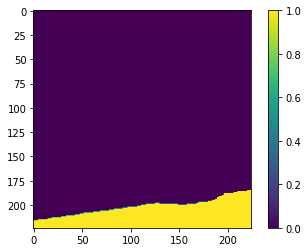

In [34]:
# 이미지로 확인
# 아마 노란색으로 된 부분이 도로인 듯 하다.
plt.imshow(train_generator[0][1][0].astype(np.float32))
plt.colorbar()
plt.show()

#### Loss Fucntion 구현
- 아래 구현한 loss function의 버전(?)들을 보면...
- 1. `loss_function_2020` 버전이 있는데, 이는 2020년에 발표된 UNet++: Redesigning... 논문을 참고해서 만든 것이고
- 2. `loss_function_2018`과 `loss_function_2018_2`는 원래 발표된 2018년 논문 버전을 따른 것이다.
- 그러나 버전을 달리한 이유는, Deep Supervision을 사용한 모델의 예측값의 경우 `(4, batch_size, 224, 224, 1)`의 총 5차원 텐서를 반환하게 되는데, 이 때 맨 앞의 4, 즉 4개의 각기 다른 output의 로스값을 구해야하는지 잘 몰라서 실험해본 것이다.
- 결과적으로 `loss_function_2018`은 `... zip #1 argument must support iteration`과 비슷한 오류가 뜨면서 실패했다.(실패한 이유는 모르겠다. 그냥 텐서는 저런 식으로 iteration이 안되나...?)
- 그리고 **궁극적으로** 해당 loss_function들은 전부 다 모델 훈련 시 `nan` 값 반환, 혹은 `비슷한 수준의 음수`에서 벗어나질 않아서 그냥 중간에 `binary_crossentropy`로 loss 함수를 변경하였다.

In [35]:
@tf.function
def loss_function_2020(y_true, y_pred):
    assert len(y_pred.shape) == 3
    term_1 = tf.math.multiply(y_true, tf.math.log(y_pred))
    term_2 = tf.math.multiply(y_true * 2.0, y_pred) / (y_true ** 2.0 + y_pred ** 2.0)
    L = tf.reduce_sum(term_1 + term_2 * 2.0) / tf.cast(tf.reduce_prod(tf.shape(y_true)), dtype=tf.float32) * -1.0
    return L

In [36]:
@tf.function
def loss_function_2018(y_true, y_pred):
    # assert len(y_preds.shape) == 3 and y_preds.shape[2] == 224
    print(y_true.shape)
    print(y_pred.shape)
    L_list = []
    for i in range(tf.shape(y_pred)[0]):
        y_true_flattened = tf.reshape(y_true[i], ([tf.reduce_prod(tf.shape(y_true[i]))]))
        y_pred_flattened = tf.reshape(y_pred[i], ([tf.reduce_prod(tf.shape(y_pred[i]))]))
        term_1 = (1/2) * y_true_flattened * tf.math.log(y_pred_flattened)
        term_2 = (2.0 * y_true_flattened * y_pred_flattened) / (y_true_flattened + y_pred_flattened)
        L = term_1 + term_2
        L_list.append(L)
    return tf.reduce_sum(L_list, axis=0) / tf.cast(-tf.shape(y_true)[0], dtype=tf.float32)

In [37]:
@tf.function
def loss_function_2018_2(y_true, y_pred):
    # assert len(y_pred.shape) == 4 and y_pred.shape[2] == 224
    y_true_flattened = tf.reshape(y_true, (tf.shape(y_true)[0], -1))
    y_pred_flattened = tf.reshape(y_pred, (tf.shape(y_pred)[0], -1))
    term_1 = (1/2) * y_true_flattened * tf.math.log(y_pred_flattened)
    term_2 = (2.0 * y_true_flattened * y_pred_flattened) / (y_true_flattened + y_pred_flattened)
    L_batch = term_1 + term_2
    L = tf.reduce_mean(L_batch, axis=0)
    return L

### 4) 모델 컴파일 및 학습
---

In [38]:
losses_bce = {'out_X_01':'binary_crossentropy',
          'out_X_02':'binary_crossentropy',
          'out_X_03':'binary_crossentropy',
          'out_X_04':'binary_crossentropy'}
losses_custom = {'out_X_01':loss_function_2018_2,
          'out_X_02':loss_function_2018_2,
          'out_X_03':loss_function_2018_2,
          'out_X_04':loss_function_2018_2}          
loss_weights = {'out_X_01':1.0,
                'out_X_02':1.0,
                'out_X_03':1.0,
                'out_X_04':1.0}            

In [39]:
unet_pp.compile(loss=losses_bce,
                loss_weights=loss_weights,
                optimizer='adam',
                metrics=[
                        #  tf.keras.metrics.MeanIoU(num_classes=num_classes)
                        ])
                                                                      # 여기서 target_class_ids는 num_classes 중에서 
                                                                      # 몇 번째꺼를 target으로 하는지를 묻는 것 같다.
                                                                      # 1개 밖에 없으니 0으로 하는 게 맞는 듯하다.

In [40]:
unet.compile(loss='binary_crossentropy',
                optimizer='adam',
                metrics=['accuracy',
                        #  tf.keras.metrics.IoU(num_classes=num_classes, target_class_ids=[0])  # 오류나서 제외
                         ]
             )

In [41]:
unet_pp_official.compile(loss=losses_bce,
                         loss_weights=loss_weights,
                         optimizer=tf.keras.optimizers.Adam(learning_rate=0.001),
                         metrics=[
                        #  tf.keras.metrics.IoU(num_classes=num_classes, target_class_ids=[0])
                        ])

#### 모델의 output 확인
- 모델이 잘 만들어졌고, output이 내가 예상한 shape으로 나오는지 확인

In [42]:
# 테스트 케이스 만들기
shape = (224, 224, 3)
test_input = tf.random.normal(shape)
test_input = tf.expand_dims(test_input, axis=0)

test_output_1 = unet_pp(test_input)
test_output_2 = unet(test_input)
test_output_3 = unet_pp_official(test_input)

In [43]:
# output shape 확인
print(f"unet_pp : {np.array(test_output_1).shape}") # 앞의 4는 Deep Supervision을 해서 총 4개의 output이 나오는 경우
print(f"unet : {np.array(test_output_2).shape}")
print(f"unet_pp_official : {np.array(test_output_3).shape}")

unet_pp : (4, 1, 224, 224, 1)
unet : (1, 224, 224, 1)
unet_pp_official : (4, 1, 224, 224, 1)


In [44]:
# 오피셜 버전 unet++에서 deep supervision을 안 할 경우(X_04만 뽑는 것)
unet_pp_official_no_ds = UNetPlusPlus(img_rows=224, img_cols=224, color_type=3, num_class=num_classes, deep_supervision=False)

test_output_4 = unet_pp_official_no_ds(test_input)
np.array(test_output_4).shape

(1, 224, 224, 1)

#### 훈련

In [45]:
EPOCHS = 50
history_unet = unet.fit(train_generator,
            validation_data=test_generator,
            steps_per_epoch=len(train_generator), # 현재 train_generator는 170개의 데이터를 5개의 1배치씩 총 34 배치로 되어 있다.
            validation_steps=len(test_generator),  # 여기서 steps_per_epochs는 epoch마다 몇 번의 배치가 들어오냐는 뜻이므로 len(train_generator)를 하면 된다.
            epochs=EPOCHS,
         verbose=2)

Epoch 1/50
34/34 - 9s - loss: 0.6857 - accuracy: 0.9547 - val_loss: 0.6781 - val_accuracy: 0.9484 - 9s/epoch - 277ms/step
Epoch 2/50
34/34 - 4s - loss: 0.6706 - accuracy: 0.9555 - val_loss: 0.6634 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 3/50
34/34 - 4s - loss: 0.6555 - accuracy: 0.9593 - val_loss: 0.6492 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 4/50
34/34 - 4s - loss: 0.6418 - accuracy: 0.9534 - val_loss: 0.6353 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 5/50
34/34 - 4s - loss: 0.6288 - accuracy: 0.9490 - val_loss: 0.6221 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 6/50
34/34 - 4s - loss: 0.6149 - accuracy: 0.9532 - val_loss: 0.6091 - val_accuracy: 0.9484 - 4s/epoch - 131ms/step
Epoch 7/50
34/34 - 4s - loss: 0.6011 - accuracy: 0.9568 - val_loss: 0.5964 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 8/50
34/34 - 4s - loss: 0.5896 - accuracy: 0.9516 - val_loss: 0.5842 - val_accuracy: 0.9484 - 4s/epoch - 130ms/step
Epoch 9/50
34/34 - 4s - 

In [46]:
EPOCHS = 50
history_unet_pp = unet_pp.fit(train_generator,
            validation_data=test_generator,
            steps_per_epoch=len(train_generator),
            validation_steps=len(test_generator),
            epochs=EPOCHS,
            verbose=2)

Epoch 1/50
34/34 - 11s - loss: 1.1313 - out_X_01_loss: 0.3535 - out_X_02_loss: 0.2637 - out_X_03_loss: 0.2571 - out_X_04_loss: 0.2570 - val_loss: 0.3756 - val_out_X_01_loss: 0.0975 - val_out_X_02_loss: 0.0980 - val_out_X_03_loss: 0.0894 - val_out_X_04_loss: 0.0907 - 11s/epoch - 329ms/step
Epoch 2/50
34/34 - 6s - loss: 0.3228 - out_X_01_loss: 0.0818 - out_X_02_loss: 0.0787 - out_X_03_loss: 0.0784 - out_X_04_loss: 0.0838 - val_loss: 0.3719 - val_out_X_01_loss: 0.1000 - val_out_X_02_loss: 0.1032 - val_out_X_03_loss: 0.0892 - val_out_X_04_loss: 0.0796 - 6s/epoch - 173ms/step
Epoch 3/50
34/34 - 6s - loss: 0.2974 - out_X_01_loss: 0.0777 - out_X_02_loss: 0.0728 - out_X_03_loss: 0.0698 - out_X_04_loss: 0.0771 - val_loss: 0.2982 - val_out_X_01_loss: 0.0817 - val_out_X_02_loss: 0.0802 - val_out_X_03_loss: 0.0689 - val_out_X_04_loss: 0.0673 - 6s/epoch - 172ms/step
Epoch 4/50
34/34 - 6s - loss: 0.3335 - out_X_01_loss: 0.0889 - out_X_02_loss: 0.0857 - out_X_03_loss: 0.0802 - out_X_04_loss: 0.0786 -

In [47]:
EPOCHS = 50
history_unet_pp_official = unet_pp_official.fit(train_generator,
            validation_data=test_generator,
            steps_per_epoch=len(train_generator),
            validation_steps=len(test_generator),
            epochs=EPOCHS,
            verbose=2)

Epoch 1/50
34/34 - 11s - loss: 1.5380 - out_X_01_loss: 0.4174 - out_X_02_loss: 0.3950 - out_X_03_loss: 0.3463 - out_X_04_loss: 0.3794 - val_loss: 1.0117 - val_out_X_01_loss: 0.1131 - val_out_X_02_loss: 0.2337 - val_out_X_03_loss: 0.3417 - val_out_X_04_loss: 0.3232 - 11s/epoch - 327ms/step
Epoch 2/50
34/34 - 4s - loss: 0.4097 - out_X_01_loss: 0.1057 - out_X_02_loss: 0.1012 - out_X_03_loss: 0.1010 - out_X_04_loss: 0.1017 - val_loss: 0.7669 - val_out_X_01_loss: 0.1078 - val_out_X_02_loss: 0.2000 - val_out_X_03_loss: 0.2038 - val_out_X_04_loss: 0.2553 - 4s/epoch - 130ms/step
Epoch 3/50
34/34 - 4s - loss: 0.3595 - out_X_01_loss: 0.0904 - out_X_02_loss: 0.0902 - out_X_03_loss: 0.0895 - out_X_04_loss: 0.0894 - val_loss: 0.4103 - val_out_X_01_loss: 0.0885 - val_out_X_02_loss: 0.1008 - val_out_X_03_loss: 0.0953 - val_out_X_04_loss: 0.1258 - 4s/epoch - 131ms/step
Epoch 4/50
34/34 - 4s - loss: 0.3230 - out_X_01_loss: 0.0822 - out_X_02_loss: 0.0818 - out_X_03_loss: 0.0798 - out_X_04_loss: 0.0792 -

In [48]:
unet_pp_path = '/content/drive/My Drive/Aiffel/GD_10/unet_pp_epoch_50.h5'

unet_pp.save(unet_pp_path)

#### 훈련 과정 시각화(loss, val_loss)

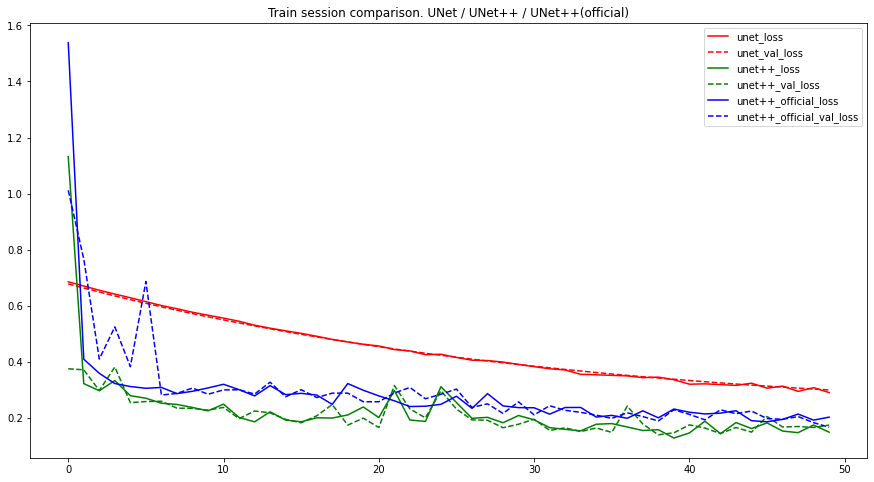

In [50]:
plt.figure(figsize=(15, 8))

plt.plot(history_unet.history['loss'], label='unet_loss', linestyle='solid', c='red')
plt.plot(history_unet.history['val_loss'], label='unet_val_loss', linestyle='dashed', c='red')

plt.plot(history_unet_pp.history['loss'], label='unet++_loss', linestyle='solid', c='green')
plt.plot(history_unet_pp.history['val_loss'], label='unet++_val_loss', linestyle='dashed', c='green')

plt.plot(history_unet_pp_official.history['loss'], label='unet++_official_loss', linestyle='solid', c='blue')
plt.plot(history_unet_pp_official.history['val_loss'], label='unet++_official_val_loss', linestyle='dashed', c='blue')

plt.legend()
plt.title('Train session comparison. UNet / UNet++ / UNet++(official)')
plt.show()

> **note**:
> - 수렴한 것을 보면 약 3,600만개의 파라미터를 가진 `unet_pp`가 가장 무난하고 좋게(?) 수렴하는 것을 볼 수 있고, 약 900만개의 파라미터를 가진 `unet_pp_official`이 처음에만 loss 값이 좀 높다가 비슷한 수준으로 수렴하는 것을 볼 수 있다.(여기서 optimizer를 살짝 다르게 되어 있는데, 이 부분은 무언가 실험하려다가 제대로 수정되지 않은 부분이다. 그러나 최종적으로 `adam`의 기본적인 형태와 동일하게 구현된 것으로 판단한다.)
> - 기본 `unet`은 loss 값 수렴이 요동치지 않으면서 수렴한 것을 볼 수 있다.

#### pre_trained된 기본 UNet 불러오기
- 여기서 학습된 UNet과 비교하기 위해 가져옴

In [52]:
unet_path = training_path + '/seg_model_unet.h5'

unet_trained = tf.keras.models.load_model(unet_path)

### 5) 모델 평가
---

In [53]:
# 예측값 이미지 뽑아내는 함수 만들기
def get_output(model, preproc, image_path, label_path, deep_supervision):
    origin_img = skimage.io.imread(image_path)
    data = {"image":origin_img}
    processed = preproc(**data)
    output = model(np.expand_dims(processed["image"]/255,axis=0))
    if deep_supervision:
        output = tf.reduce_mean(output, axis=0)
    output = (output[0].numpy()>=0.5).astype(np.uint8).squeeze(-1)*255   # 배치사이즈 차원 벗기기(output[0]), 3차원 -> 2차원 만들기 squeeze : (224, 224, 1) -> (224, 224)
    prediction = output/255   # 0 ~ 1 사이 확률로 다시 만들어주기
    
    output = PIL.Image.fromarray(output)
    background = PIL.Image.fromarray(origin_img).convert('RGBA')
    output = output.resize((origin_img.shape[1], origin_img.shape[0])).convert('RGBA')
    output = PIL.Image.blend(background, output, alpha=0.5)
    output.show()   # 작동 안 함

    if label_path:   
        label_img = skimage.io.imread(label_path)
        label_data = {"image":label_img}
        label_processed = preproc(**label_data)
        label_processed = label_processed["image"]
        target = (label_processed == 7).astype(np.uint8)*1   # 라벨에서 도로로 기재된 영역
        target_for_print = PIL.Image.fromarray(target)
        target_for_print = target_for_print.resize((origin_img.shape[1], origin_img.shape[0]))

        return output, prediction, target, target_for_print
    else:
        return output, prediction, _1, _2

In [54]:
# IoU 계산하는 함수
def calculate_iou_score(target, prediction):
    intersection = np.logical_and(target, prediction)
    union = np.logical_or(target, prediction)
    iou_score = float(np.sum(intersection)) / float(np.sum(union))
    # print('IoU : %f' % iou_score )
    return iou_score

#### Training 데이터셋에 대한 예측 확인하기(라벨도 같이 확인)

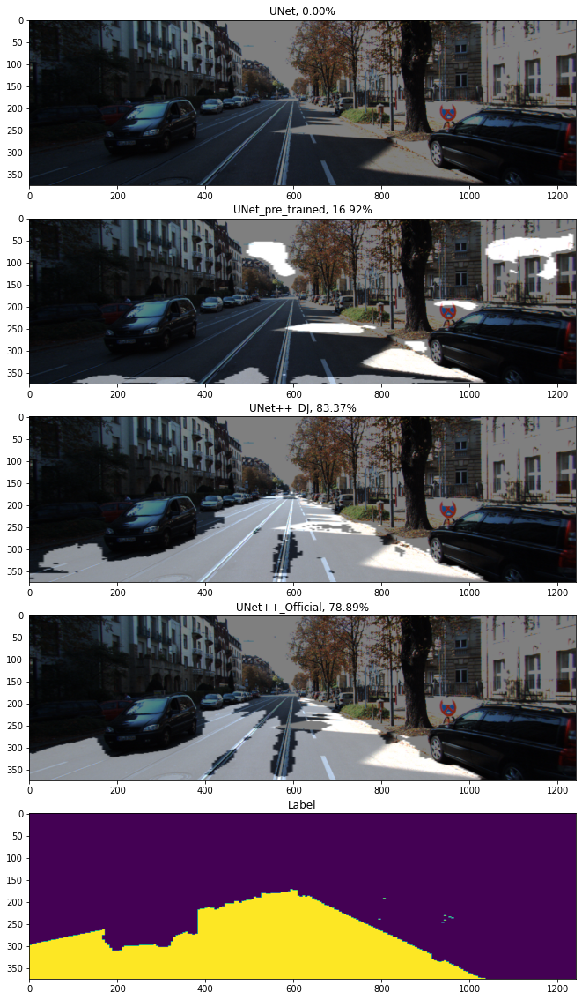

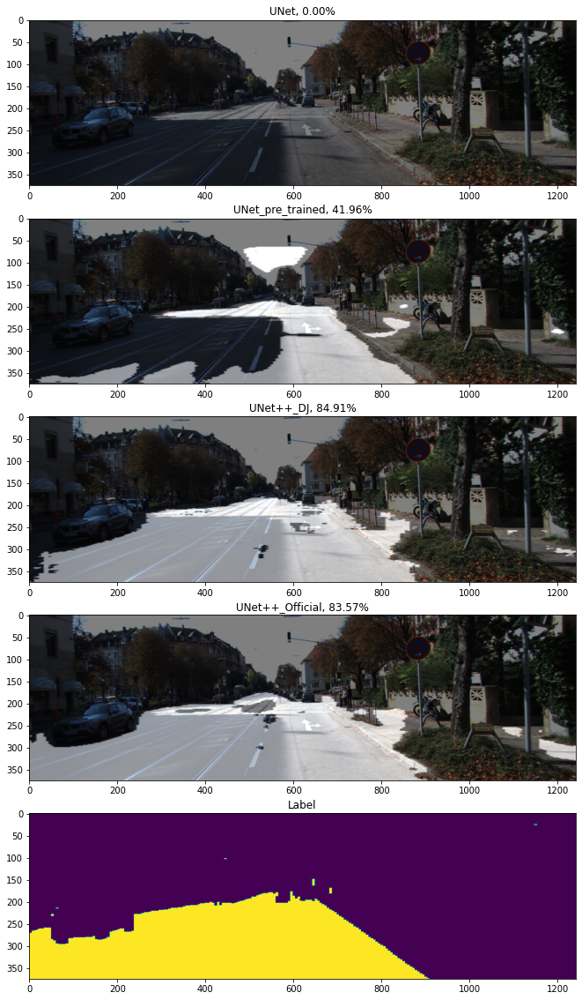

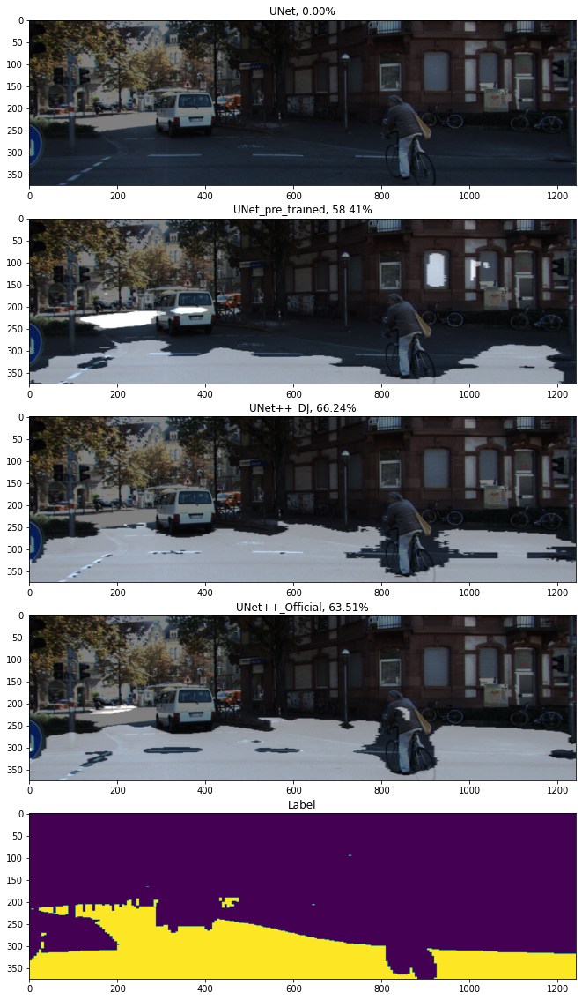

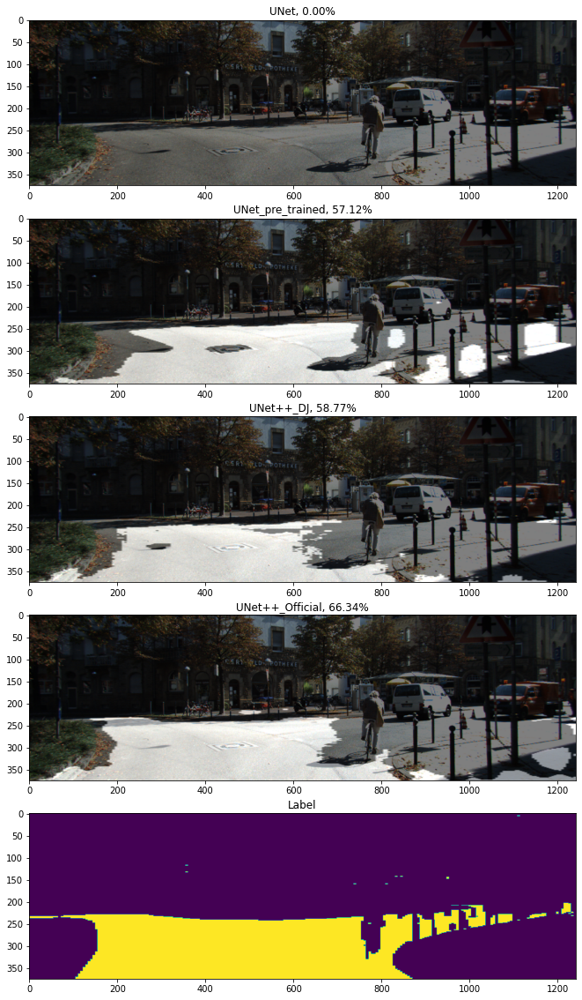

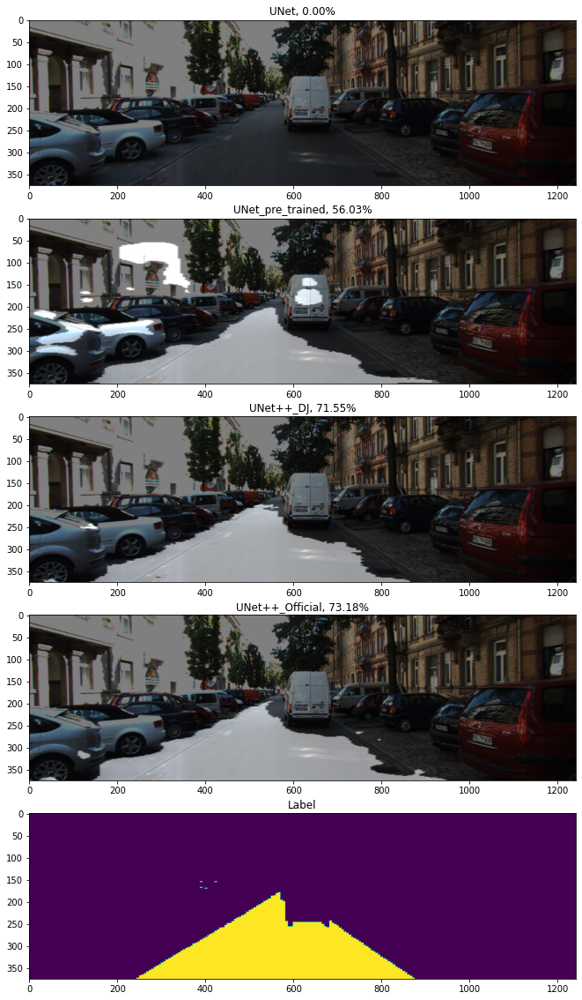

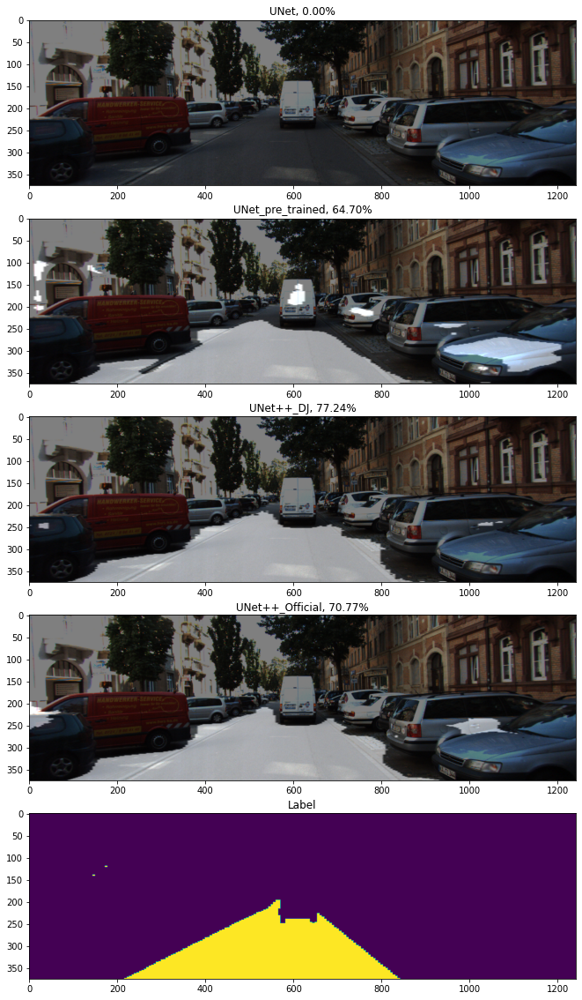

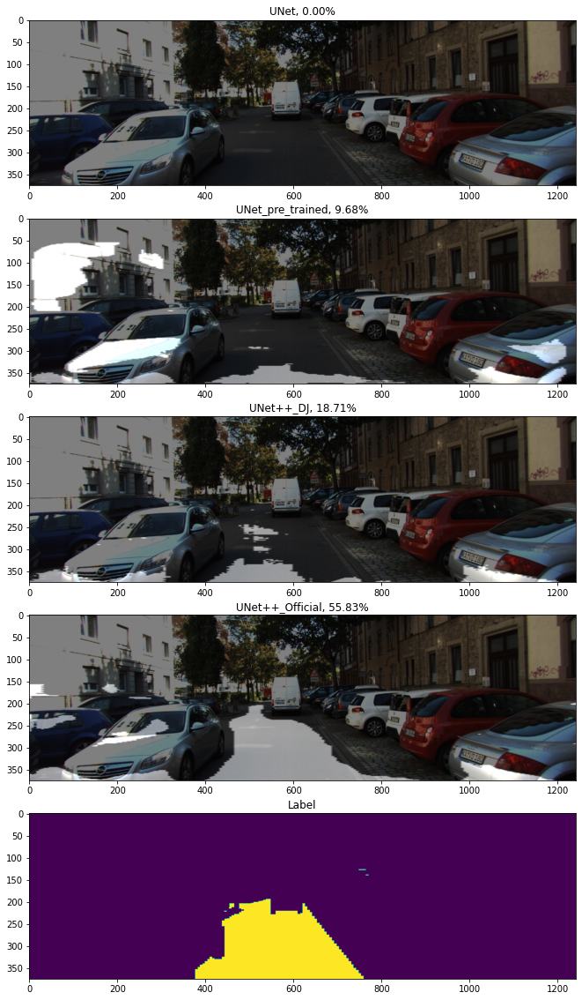

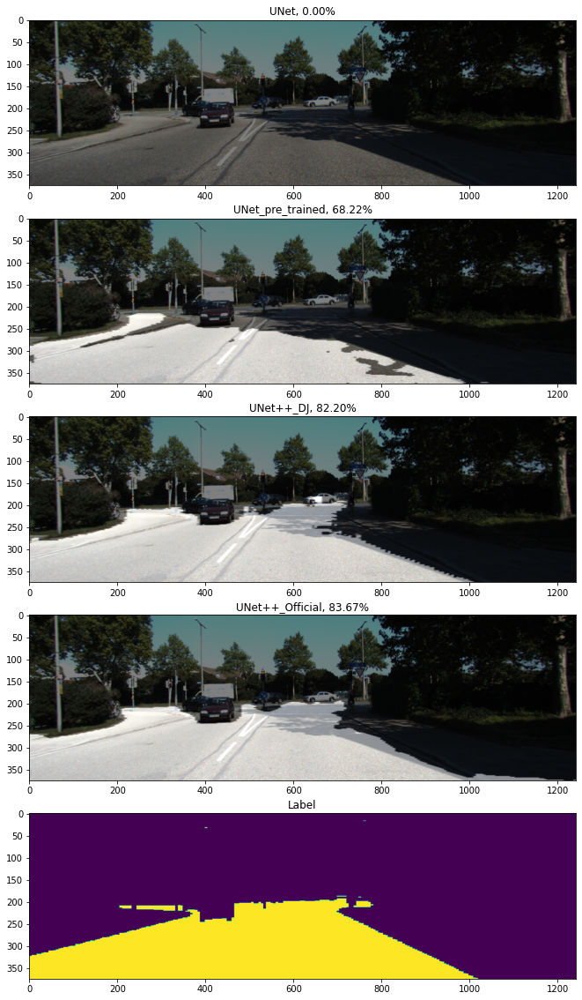

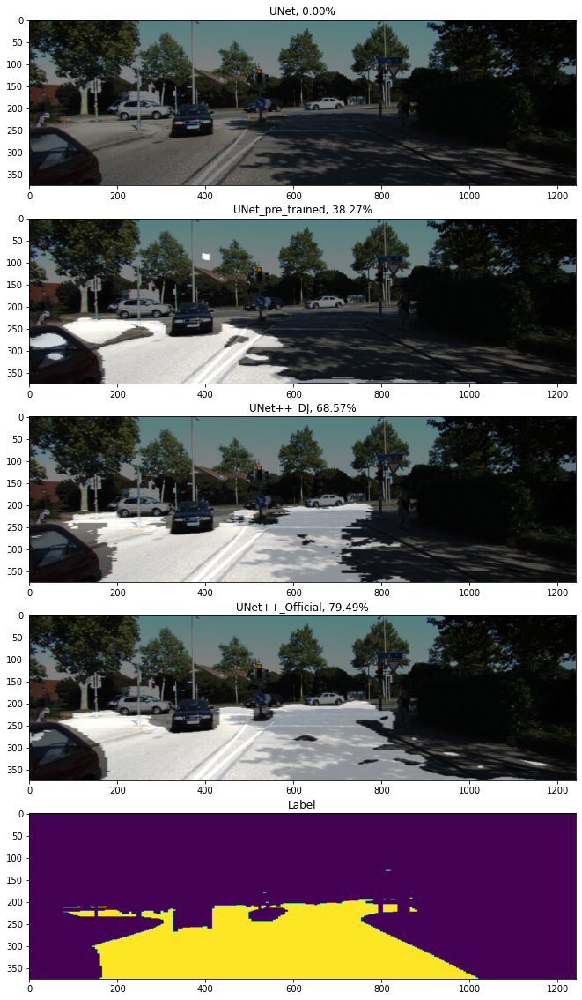

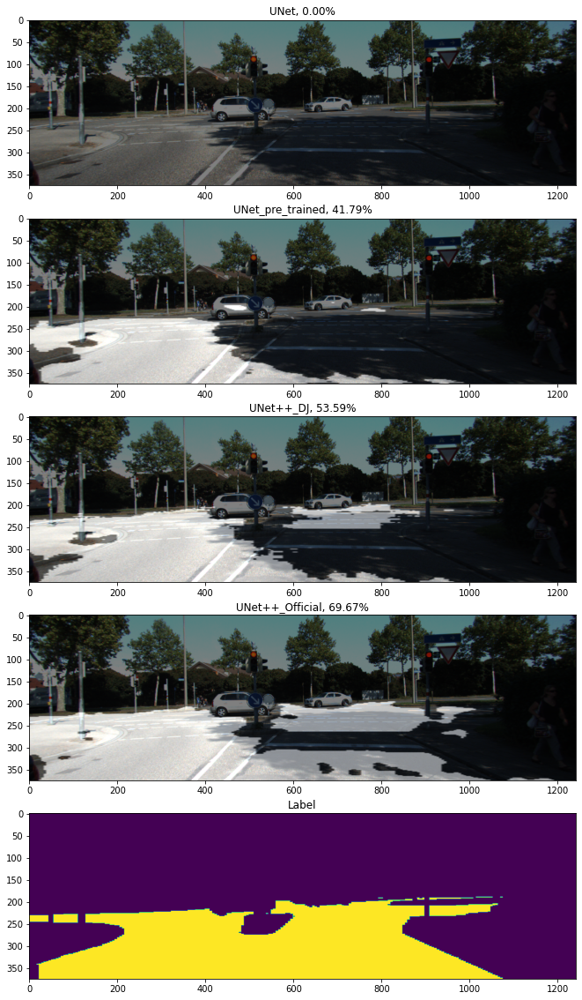

In [55]:
for i in range(10):
    output_1, prediction_1, target, target_for_print = get_output(unet, test_aug, image_path=training_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=False)
    iou_score_1 = calculate_iou_score(target, prediction_1)
    output_2, prediction_2, target, target_for_print = get_output(unet_trained, test_aug, image_path=training_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=False)
    iou_score_2 = calculate_iou_score(target, prediction_2)
    output_3, prediction_3, target, target_for_print = get_output(unet_pp, test_aug, image_path=training_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=True)
    iou_score_3 = calculate_iou_score(target, prediction_3)
    output_4, prediction_4, target, target_for_print = get_output(unet_pp_official, test_aug, image_path=training_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=True)
    iou_score_4 = calculate_iou_score(target, prediction_4)

    plt.figure(figsize=(20, 20))
    plt.subplot(5, 1, 1)
    plt.imshow(output_1)
    plt.axis=('off')
    plt.title(f"UNet, {iou_score_1 * 100 :.2f}%")

    plt.subplot(5, 1, 2)
    plt.imshow(output_2)
    plt.axis=('off')
    plt.title(f"UNet_pre_trained, {iou_score_2 * 100 :.2f}%")

    plt.subplot(5, 1, 3)
    plt.imshow(output_3)
    plt.axis=('off')
    plt.title(f"UNet++_DJ, {iou_score_3 * 100 :.2f}%")

    plt.subplot(5, 1, 4)
    plt.imshow(output_4)
    plt.axis=('off')
    plt.title(f"UNet++_Official, {iou_score_4 * 100 :.2f}%")

    plt.subplot(5, 1, 5)
    plt.imshow(target_for_print)
    plt.axis=('off')
    plt.title(f"Label")
    plt.show()
    print("==============")
    print("==============")

#### Test 데이터셋에 대한 예측 결과 확인하기

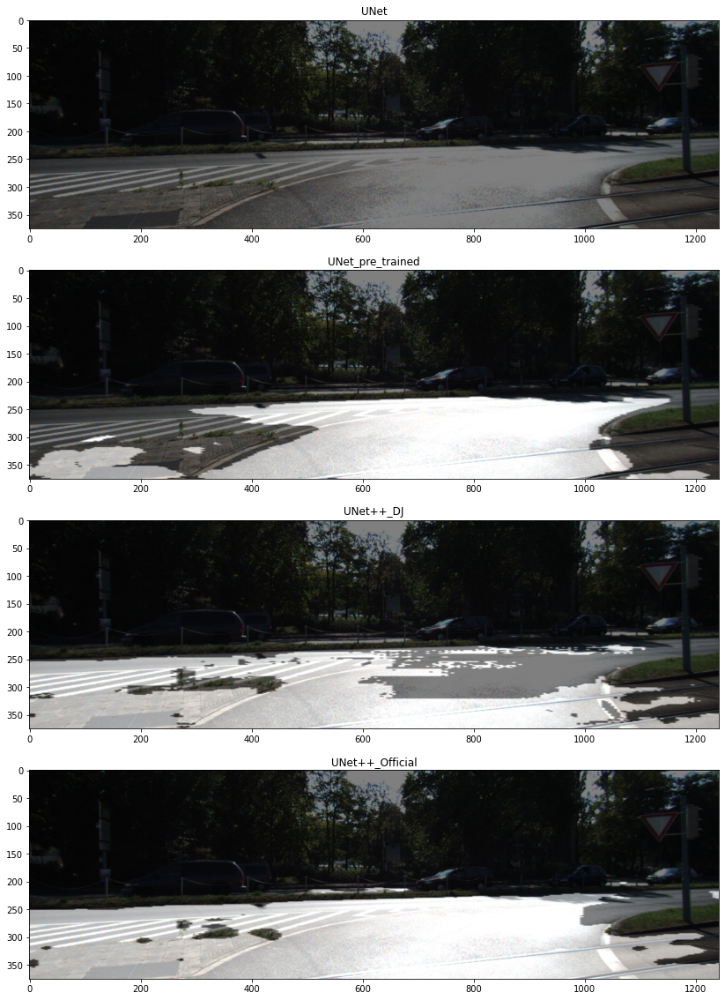

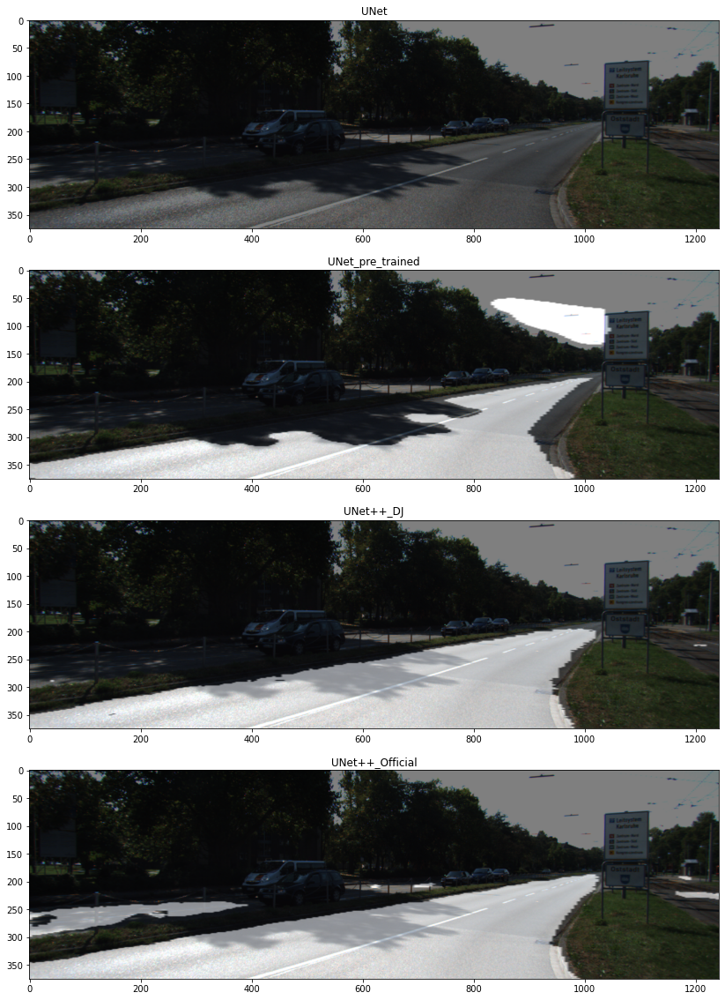

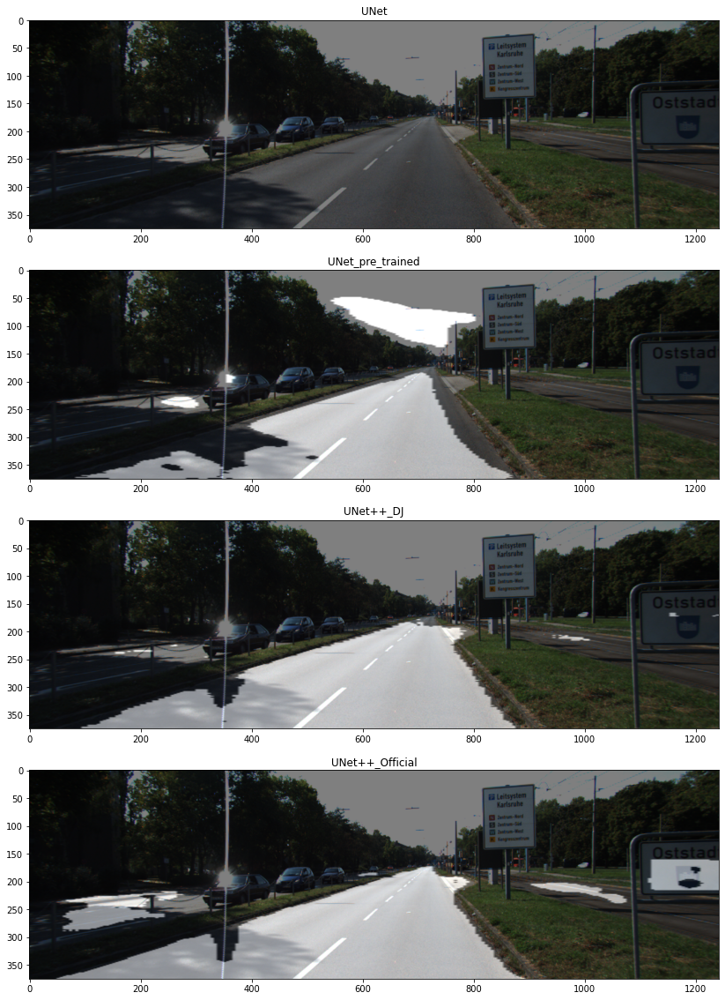

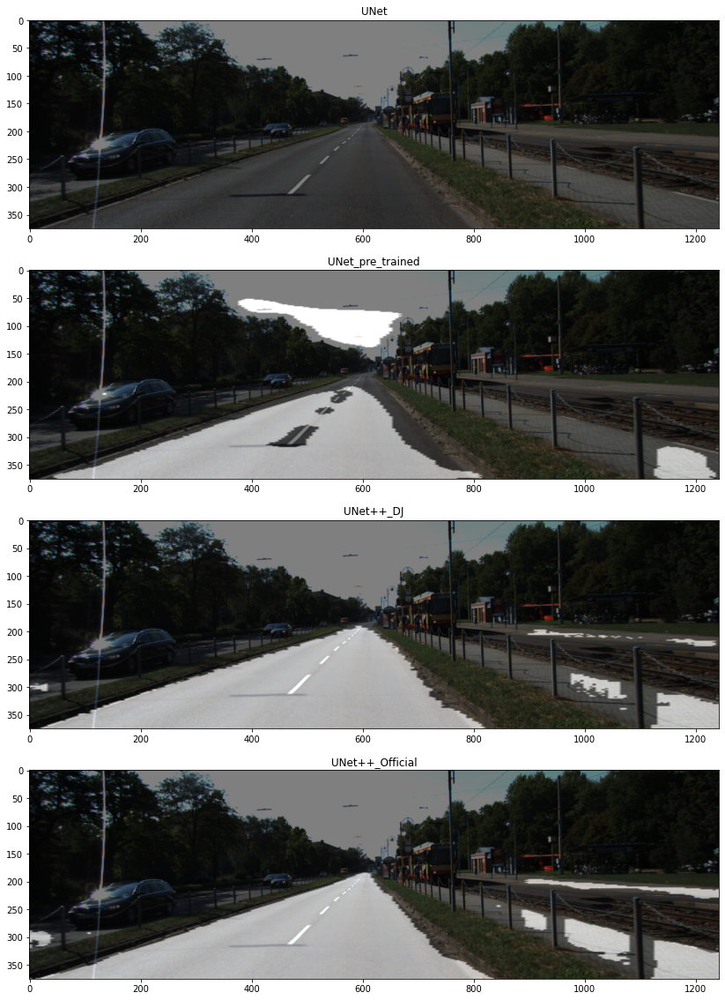

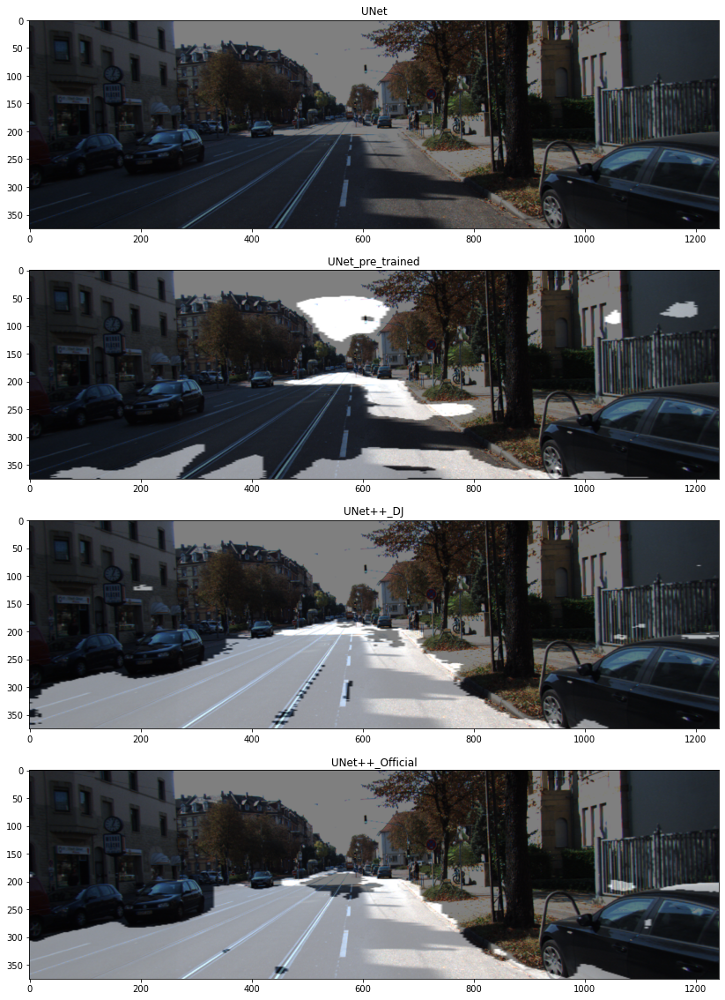

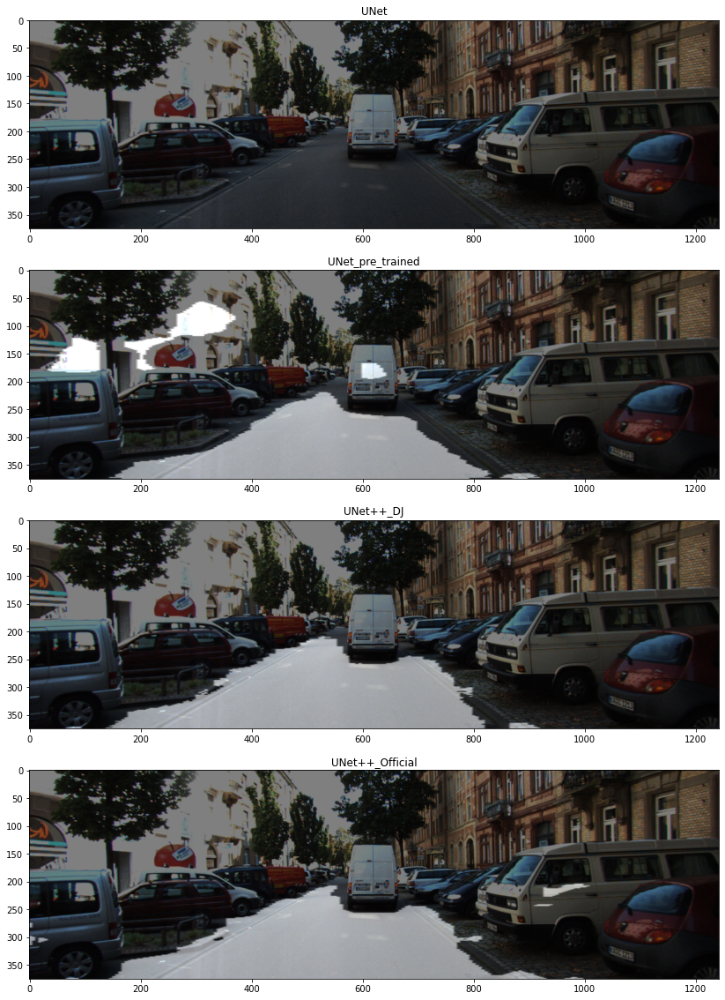

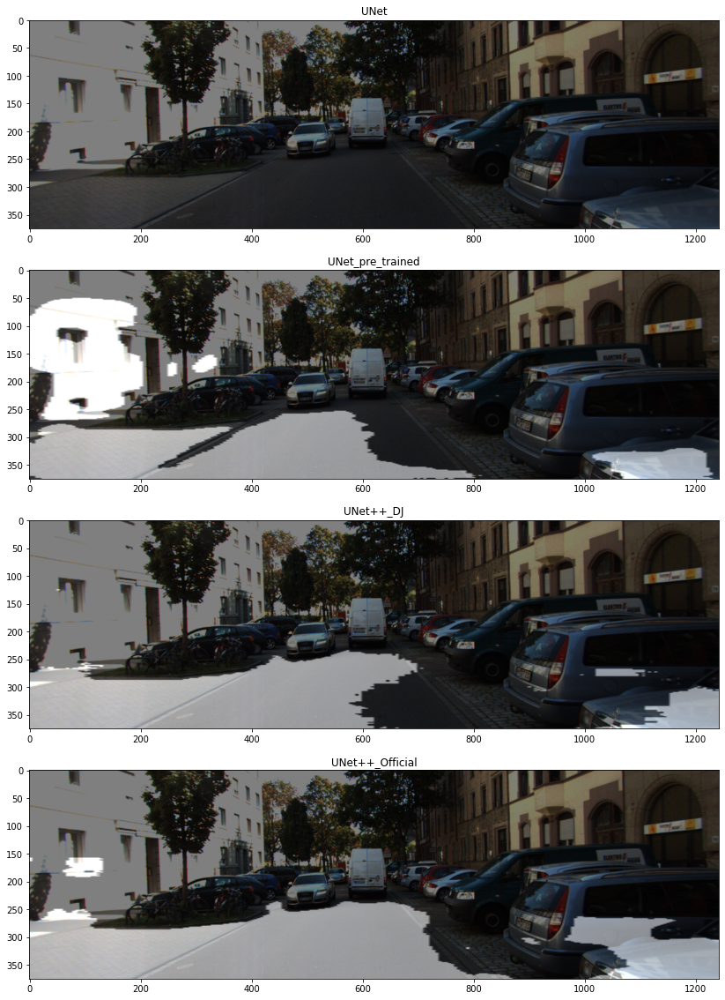

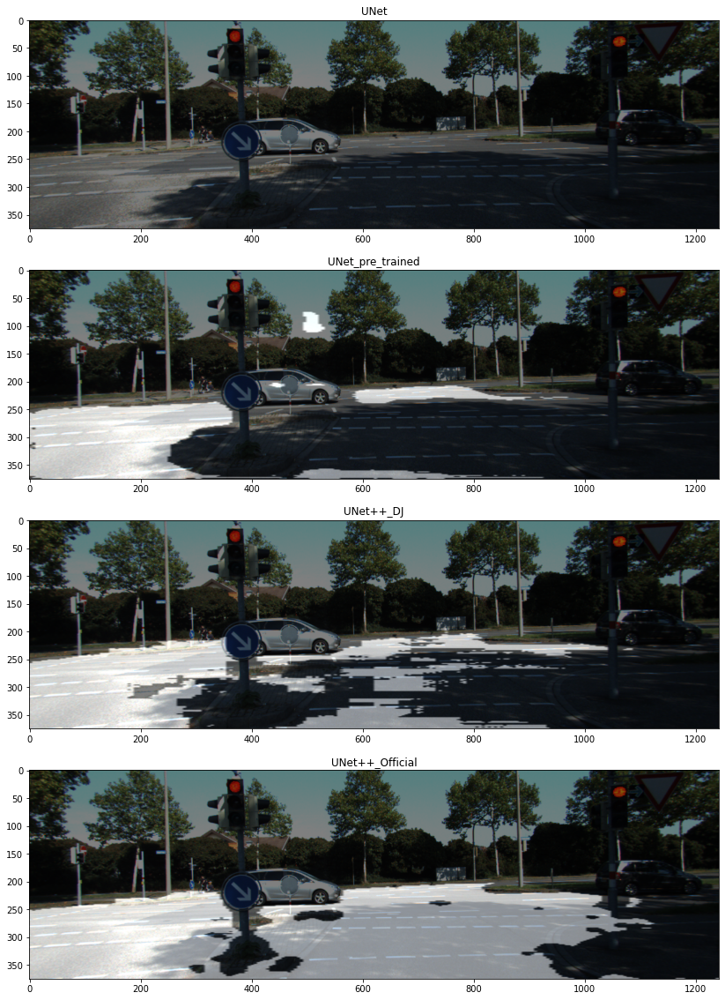

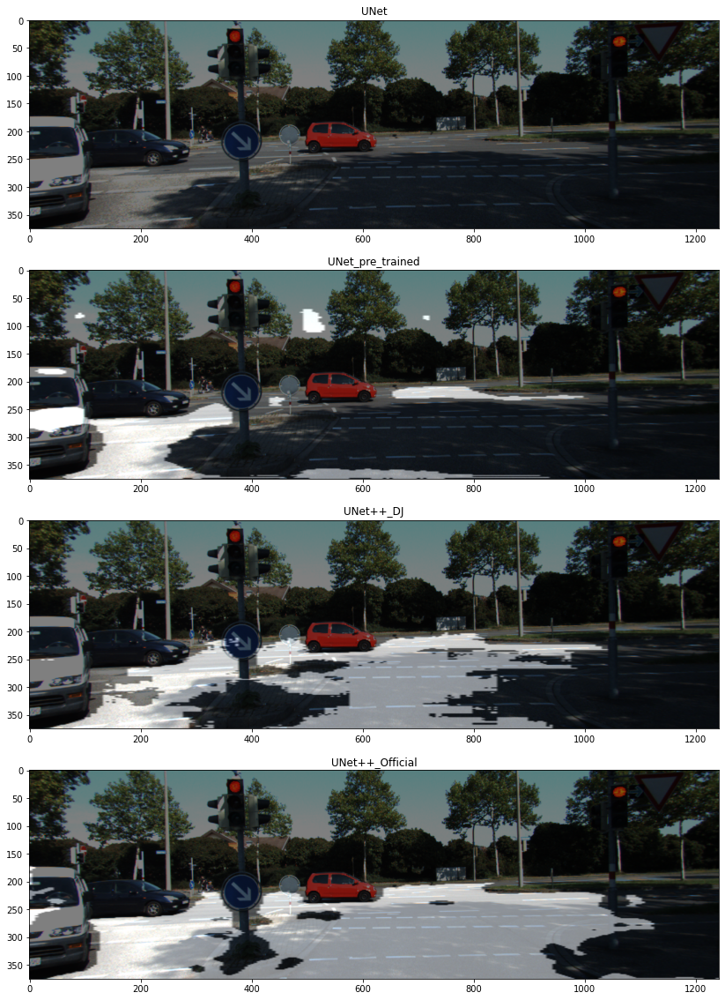

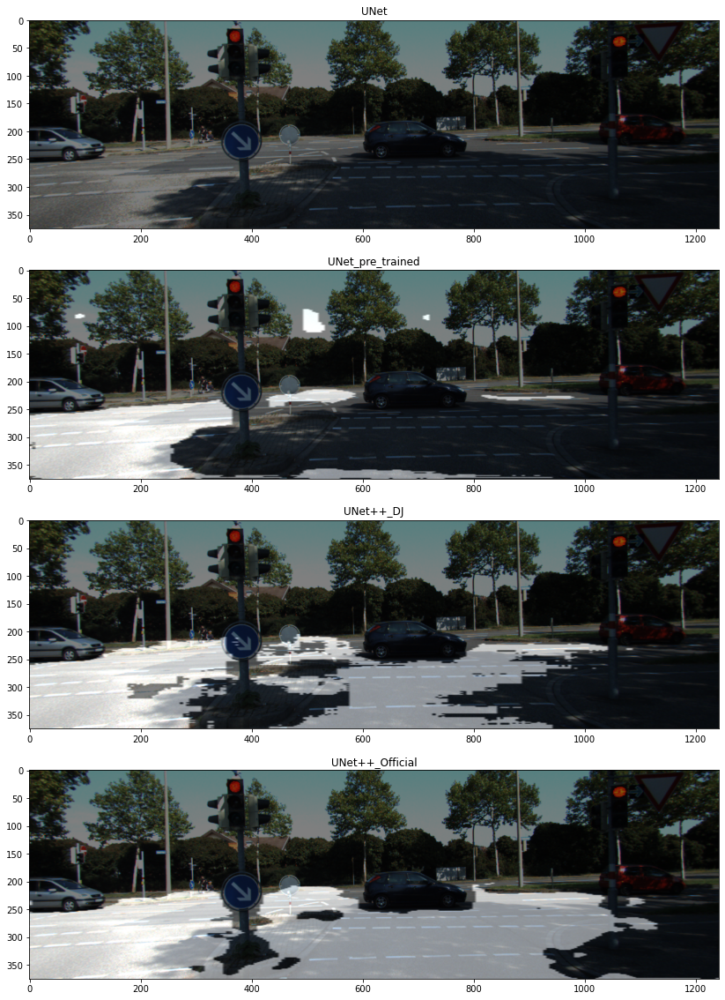

In [56]:
for i in range(10):
    output_1, prediction_1, target, target_for_print = get_output(unet, test_aug, image_path=testing_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=False)
    # iou_score_1 = calculate_iou_score(target, prediction_1)
    output_2, prediction_2, target, target_for_print = get_output(unet_trained, test_aug, image_path=testing_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=False)
    # iou_score_2 = calculate_iou_score(target, prediction_2)
    output_3, prediction_3, target, target_for_print = get_output(unet_pp, test_aug, image_path=testing_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=True)
    # iou_score_3 = calculate_iou_score(target, prediction_3)
    output_4, prediction_4, target, target_for_print = get_output(unet_pp_official, test_aug, image_path=testing_path + f'/image_2/00{str(i).zfill(4)}_10.png', label_path=training_path + f'/semantic/00{str(i).zfill(4)}_10.png', deep_supervision=True)
    # iou_score_4 = calculate_iou_score(target, prediction_4)

    plt.figure(figsize=(20, 20))
    plt.subplot(4, 1, 1)
    plt.imshow(output_1)
    plt.axis=('off')
    plt.title(f"UNet") #, {iou_score_1 * 100 :.2f}%")

    plt.subplot(4, 1, 2)
    plt.imshow(output_2)
    plt.axis=('off')
    plt.title(f"UNet_pre_trained") #, {iou_score_1 * 100 :.2f}%")

    plt.subplot(4, 1, 3)
    plt.imshow(output_3)
    plt.axis=('off')
    plt.title(f"UNet++_DJ") #, {iou_score_2 * 100 :.2f}%")

    plt.subplot(4, 1, 4)
    plt.imshow(output_4)
    plt.axis=('off')
    plt.title(f"UNet++_Official") #, {iou_score_3 * 100 :.2f}%")

    # plt.subplot(4, 1, 4)
    # plt.imshow(target_for_print)
    # plt.axis=('off')
    # plt.title(f"Label")
    plt.show()
    print("==============")
    print("==============")

> **note**:
> - 왜인지는 모르겠지만, 여기서 훈련된 UNet의 경우 학습이 제대로 되지 않은 것으로 보인다. 그래서 최종적으로 도로 영역이 검출되지 않는다.(이는 threshold를 낮추면 달라질 수도 있고, 아님 모델의 gradient 및 output 자체가 이상하게 수렴한 상태일 수도 있다.)
> - 나머지의 경우 대체적으로 UNet++가 UNet보다 정성적, 정량적으로 더 좋은 예측성을 보여줬고, 많은 경우 파라미터 수가 월등히 적은 **UNet++ 공식 버전**이 이번에 구현된 내 모델보다 성능이 더 좋게 나왔다.(차이점으로는 중간에 Dropout이나 skip_connection 부분의 conv 레이어 kernel_size 및 레이어 수를 들 수 있겠다.)